# Reliable Homogenous Ensemble Learning
We are applying homogenous ensemble learning in highly imbalanced data. Data science is about understanding the data. Our aim is to produce more robust and reliable user preference detection system that is capable of predicting user preference neglecting the messy distribution of inputting data.

**Name(s)**: Kaiwen Bian & Bella Wang

**Website Link**: https://kevinbian107.github.io/ensemble-imbalanced-data/

### Content for this Project
1. Introduction
2. Data Cleaning, Transformation, and EDA
    - Transformation
    - Univariate & Bivariate Analysis
    - Aggreagted Analysis
    - Textual Feature Analysis
3. Assessment of Missingness Mechanism
    - NMAR Analysis
    - MAR Anlaysis
4. Permutation Testing of TF-IDF
5. Framing a Predictive Question
6. Random Forest Introduction
7. Baseline Model: An Naive Approach
    - Handling Missingness in Data
    - Train/Val/Test Split
    - Feature Engineering
8. Final Model: Homogenous Ensemble Learning
    - Feature Engineering (Back to EDA)
    - Model Pipeline
    - Hyperparameter Tuning
    - Evaluation
        - Feature Importantness
        - Confusion Matrix, Evaluation Metrics, and ROC_AUC
9. Fairness Analysis

In [1]:
# for eda and modeling
import pandas as pd
import numpy as np
pd.options.plotting.backend = 'plotly'
from utils.dsc80_utils import *
from itertools import chain

# Introduction
Recipes and ratings play a pivotal role in our everyday lives, influencing various aspects from culinary experiences to social interactions. Predicting users' preferences is particularly crucial as it enables personalized experiences and enhances efficiency in content discovery. In our analysis, we focus on how to predict user preferences based on various numerical and textual features. Our approach involves employing advanced techniques such as TF-IDF transformation, PCA, and a homogenous ensemble learning method, specifically Random Forest, to construct a reliable multi-class classifier with more **robust** and **reliable** predictions even facing imbalanced datasets, ensuring **dependable predictions** in scenarios where data distribution is skewed.

With the basics from this project moving forward, this project is building a foundation for:
1. From a **practical perspective**, we can build recommender systems that can recommend better recipes to users to better fit their needs and appetites with a much more **robust** and **reliable** system no matter how messy the training data is (usual real world data).
2. From a **theoritical perspective**, this project provide understanding to an potential approach towards solving issues that is relevant to highly imbalanced data, which is quite often in **real-world data**.

# Data Cleaning and Exploratory Data Analysis

In [2]:
interactions = pd.read_csv('food_data/RAW_interactions.csv')
recipes = pd.read_csv('food_data/RAW_recipes.csv')

## Merging
Initial merging is needed for the two dataset to form 1 big data set
1. Left merge the recipes and interactions datasets together.
2. In the merged dataset, fill all ratings of 0 with np.nan. (Think about why this is a reasonable step, and include your justification in your website.)
3. Find the average rating per recipe, as a Series.
4. Add this Series containing the average rating per recipe back to the recipes dataset however you’d like (e.g., by merging). Use the resulting dataset for all of your analysis. (For the purposes of Project 4, the 'review' column in the interactions dataset doesn’t have much use.)

## Transformation
1. Some columns, like `nutrition`, contain values that look like lists, but are actually strings that look like lists. We turned the strings into actual columns for every unique value in those lists
2. Convert to list for `steps`, `ingredients`, and `tags`
3. Convert `date` and `submitted` to Timestamp object and rename as `review_date` and `recipe_date`
4. Convert Types
5. Drop same `id` (same with `recipe_id`)
6. Replace 'nan' with np.NaN

### Type Logic
1. `String`: [name, contributor_id, user_id, recipe_id, ]
    - quantitative or qualitative, but cannot perform mathamatical operations (**quntitative discrete**)
    - `name` is the name of recipe
    - `contributor_id` is the author id of the recipe _(shape=7157)_
    - `recipe_id` is the id of teh recipe _(shape=25287)_
        - `id` from the original dataframe also is the id of the recipe, dropped after merging
    - `user_id` is the id of the reviewer _(shape=8402)_
2. `List`: [tags, steps, description, ingredients, review]
    - qualitative, no mathamatical operation (**qualitative discrete**)
3. `int`: [n_steps, minutes, n_ingredients, rating]
    - quantitative mathamatical operations allowed (**quantitative continuous**)
4. `float`: [avg_rating, calories, total_fat sugar, sodium, protein, sat_fat, carbs]
    - quantitative mathamatical operations allowed (**quantitative continuous**)
5. `Timestamp`: [recipe_date, review_date]
    - quantitative mathamatical operations allowed (**quantitative continuous**)

Below are the full implementation of `initial`, which does the merge conversion, then `transform`, whcih carries out the neccessary transformation described above

In [3]:
def initial(df):
    '''Initial claeaning and megrging of two df, add average ratings'''
    # fill 0 with np.NaN
    df['rating'] = df['rating'].apply(lambda x: np.NaN if x==0 else x)

    # not unique recipe_id
    avg = df.groupby('recipe_id')[['rating']].mean().rename(columns={'rating':'avg_rating'})
    df = df.merge(avg, how='left', left_on='recipe_id',right_index=True)
    return df

def transform_df(df):
    '''Transforming nutrition to each of its own catagory,
    tags, steps, ingredients to list,
    submission date to timestamp object,
    convert types,
    and remove 'nan' to np.NaN'''

    # Convert nutrition to its own caatgory
    data = df['nutrition'].str.strip('[]').str.split(',').to_list()
    name = {0:'calories',1:'total_fat',2:'sugar',3:'sodium',4:'protein',5:'sat_fat',6:'carbs'}
    new = pd.DataFrame(data).rename(columns=name)

    df = df.merge(new,how='inner',right_index=True, left_index=True)
    df = df.drop(columns=['nutrition'])

    # Convert to list
    def convert_to_list(text):
        return text.strip('[]').replace("'",'').split(', ')
    
    df['tags'] = df['tags'].apply(lambda x: convert_to_list(x))
    df['ingredients'] = df['ingredients'].apply(lambda x: convert_to_list(x))

    # it's correct, just some are long sentences, doesn't see "'", notice spelling
    df['steps'] = df['steps'].apply(lambda x: convert_to_list(x)) #some white space need to be handled

    # submission date to time stamp object
    format ='%Y-%m-%d'
    df['submitted'] = pd.to_datetime(df['submitted'],format=format)
    df['date'] = pd.to_datetime(df['date'],format=format)

    # drop not needed & rename
    df = df.drop(columns=['id']).rename(columns={'submitted':'recipe_date','date':'review_date'})

    # Convert data type
    df[['calories','total_fat','sugar',
        'sodium','protein','sat_fat','carbs']] = df[['calories','total_fat','sugar',
                                                     'sodium','protein','sat_fat',
                                                     'carbs']].astype(float)
    
    df[['user_id','recipe_id','contributor_id']] = df[['user_id','recipe_id',
                                                       'contributor_id']].astype(str)

    # there are 'nan' values, remove that
    for col in df.select_dtypes(include='object'):
        df[col] = df[col].apply(lambda x: np.NaN if x=='nan' else x)

    return df

In [4]:
merged = recipes.merge(interactions, how='left', left_on='id', right_on='recipe_id')
cleaned = (merged
           .pipe(initial)
           .pipe(transform_df))

In [5]:
display_df(cleaned)

,name,minutes,contributor_id,recipe_date,...,sodium,protein,sat_fat,carbs
0,1 brownies in the world best ever,40,985201,2008-10-27,...,3.0,3.0,19.0,6.0
1,1 in canada chocolate chip cookies,45,1848091,2011-04-11,...,22.0,13.0,51.0,26.0
2,412 broccoli casserole,40,50969,2008-05-30,...,32.0,22.0,36.0,3.0
...,...,...,...,...,...,...,...,...,...
234426,cookies by design sugar shortbread cookies,20,506822,2008-04-15,...,4.0,4.0,11.0,6.0
234427,cookies by design sugar shortbread cookies,20,506822,2008-04-15,...,4.0,4.0,11.0,6.0
234428,cookies by design sugar shortbread cookies,20,506822,2008-04-15,...,4.0,4.0,11.0,6.0


Now this code would be used later on when we need to groupby using the `recipe_id` column or the `user_id` column for different purposes. The handling for different columns are also defined as below, which is diffeernt according to waht we need the columns are for later on in the modeling process.

In [6]:
def group_recipe(df):
    func = lambda x: list(x)
    check_dict = {'minutes':'mean', 'n_steps':'mean', 'n_ingredients':'mean',
                'avg_rating':'mean', 'rating':'mean', 'calories':'mean',
                'total_fat':'mean', 'sugar':'mean', 'sodium':'mean',
                'protein':'mean', 'sat_fat':'mean', 'carbs':'mean',
                'steps':'first', 'name':'first', 'description':'first',
                'ingredients':func, 'user_id':func, 'contributor_id':func,
                'review_date':func, 'review':func,  'recipe_date':func,
                'tags':lambda x: list(chain.from_iterable(x))}

    grouped = df.groupby('recipe_id').agg(check_dict)
    #grouped['rating'] = grouped['rating'].astype(int)

    return grouped

def group_user(df):
    '''function for grouping by unique user_id and concating all steps/names/tags 
    of recipe and averaging rating give'''
    
    return (df
            .groupby('user_id')['steps','rating','name','tags','minutes','calories',
                                'description','n_ingredients','n_steps','ingredients',
                                'contributor_id','review']
            .agg({'steps':lambda x: list(chain.from_iterable(x)),
                  'name':lambda x: list(x),
                  'tags':lambda x: list(chain.from_iterable(x)),
                  'rating':'mean',
                  'minutes':'mean',
                  'calories':'mean',
                  'description':lambda x: list(x),
                  'n_ingredients':'mean',
                  'n_steps':'mean',
                  'ingredients':lambda x: list(chain.from_iterable(x)),
                  'contributor_id':lambda x: list(x),
                  'review':lambda x: list(x),
                  })
    )

### Outliers

In [7]:
display_df(cleaned[['sodium','calories','minutes']].describe(),8)

,sodium,calories,minutes
count,234429.00,234429.00,2.34e+05
mean,29.26,419.53,1.07e+02
std,129.56,583.22,3.29e+03
min,0.00,0.00,0.00e+00
25%,5.00,170.70,2.00e+01
50%,15.00,301.10,3.50e+01
75%,33.00,491.10,6.00e+01
max,29338.00,45609.00,1.05e+06


Looks like that our data have a lot of outliers! we might want to write a function to deal with that. Here we are writing the function `outlier`, which will be used quite often later on.

In [8]:
def outlier(df):
    '''take care of outliers in the data frame'''
    # Remove outlier in graph dierctly

    check = ['minutes', 'n_steps', 'n_ingredients', 'calories', 'total_fat',
             'sugar', 'sodium', 'protein', 'sat_fat', 'carbs']
    for col in check:
        q_low = df[col].quantile(0.01)
        q_hi  = df[col].quantile(0.99)
        df = df[(df[col]<q_hi) & (df[col]>q_low)]

    return df

## Univariate & Bivariate Analysis
Okay, after data cleaning, let's draw some graph to see what kind of data we are dealing with

### Univariate Analysis
Let's first examine the `rating` column

In [9]:
px.violin(cleaned, x='rating', title='rating univariate distribution')

Looks like the data are kind of **imbalanced** in `rating` (at this point, we thought that this wouldn't effect our modle too much, but it turns out later to be one of the main challenge that we need to deal with during the moeling phase)

In [10]:
px.violin(cleaned, x=['n_steps', 'n_ingredients'], title='n_ingredients and n_steps univariate distribution')

Seems like there is a **threshold point** for `n_ingredients` and `n_steps`, this will be utilized later in our **feature engineering** section

### Bivariate Analysis

In [11]:
px.scatter_matrix(cleaned,
                  ['sugar', 'total_fat', 'rating'],
                  title='calories, total_fat, and rating correlations')

It also seems like more `sugar` and more `total_fat` (transformed from `nutrition`) seems to be related to higher `rating`! This is quite suprising!

In [12]:
px.scatter_matrix(cleaned,
                  ['n_steps', 'n_ingredients', 'rating'],
                  title='n_step, n_ingredients, and rating correlations')

Seems like there is some sort of relationships between `n_steps`, `n_ingredients`, and the `rating` column. However, this relationship doesn't seem to be that exact. In a later section we might use this idea.

## Aggregated Analysis

Now we can first use the groupby function that we have implemented to look at some aggregated data first before using it for the next few sections

In [13]:
recipe_group = cleaned.pipe(group_recipe)
display_df(recipe_group, 5)

,minutes,n_steps,n_ingredients,avg_rating,...,review_date,review,recipe_date,tags
recipe_id,,,,,,,,,
275022.0,50.0,11.0,7.0,3.0,...,"[2008-04-07 00:00:00, 2013-06-07 00:00:00, 201...",[Easy comfort food! I definitely thought it wa...,"[2008-01-01 00:00:00, 2008-01-01 00:00:00, 200...","[60-minutes-or-less, time-to-make, course, mai..."
275024.0,55.0,6.0,8.0,3.0,...,[2009-05-26 00:00:00],[When I found myself needing a dessert and hav...,[2008-01-01 00:00:00],"[60-minutes-or-less, time-to-make, course, pre..."
...,...,...,...,...,...,...,...,...,...
537671.0,135.0,54.0,12.0,NaN,...,[2018-12-15 00:00:00],"[These are an absolute work of art, but just t...",[2018-11-28 00:00:00],"[time-to-make, course, preparation, occasion, ..."
537716.0,40.0,12.0,13.0,5.0,...,[2018-12-06 00:00:00],[These were the best game day sandwiches. I co...,[2018-12-04 00:00:00],"[60-minutes-or-less, time-to-make, course, mai..."


In [14]:
px.scatter_matrix(recipe_group,
                  dimensions=['calories','n_ingredients','rating'],
                  title='grouped recipe calories, n_ingredients, and rating')

Looking at the right column of graph, it seems like the previous relationships taht we observed in no aggregation data is still preserved in the aggregated version where higher `calories` seems to be correlated to higher `rating` and `n_ingredients` seems to have some relationships with `rating` as well.

In [15]:
user_group = cleaned.pipe(group_user)
display_df(user_group, 5)

/var/folders/yt/5gdjwln55x9_stgx851x0yb80000gn/T/ipykernel_8780/2503190830.py:21: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,steps,name,tags,rating,...,n_steps,ingredients,contributor_id,review
user_id,,,,,,,,,
1000014.0,"[mix steel cut oats , 4 cups water , and salt ...",[no mess crock pot steel cut oats],"[15-minutes-or-less, time-to-make, course, mai...",5.0,...,12.0,"[steel cut oats, water, salt]",[48819],[Wow! This was so easy and good! Clean up wa...
1000048.0,"[preheat oven to 350 degrees, in large bowl , ...",[healthy banana cookies],"[30-minutes-or-less, time-to-make, course, pre...",5.0,...,7.0,"[bananas, dates, rolled oats, oil, vanilla ext...",[57042],[AWESOME!! ... \n\njust made these with the wr...
...,...,...,...,...,...,...,...,...,...
999936.0,[mix all ingredients in a bowl apart from the ...,[chickpea and pepper sandwich spread],"[15-minutes-or-less, time-to-make, course, mai...",5.0,...,3.0,"[chickpeas, black olives, red onion, fresh par...",[1018029],[Inspiring. Delicious! Thank you :p]
99994.0,"[whisk mayonnaise , lemon juice , tomato paste...","[asparagus and crab meat salad, knoephla knepf...","[30-minutes-or-less, time-to-make, course, mai...",5.0,...,11.0,"[mayonnaise, fresh lemon juice, tomato paste, ...","[305531, 430080, 685701]",[Years ago my brother-in-law made this exact r...


In [16]:
px.scatter_matrix(user_group,
                  dimensions=['calories','n_ingredients','rating'],
                  title='grouped user calories, n_ingredients, and rating')

When aggregating by user, something interesting appears, it seems like that `rating` column is not so much correlated with the `n_ingrredients` column though it is still quite correlated with the `calories` column. **Though we will not be working with this version of the aggregated data frame firectly when we are making our predictive model, this ideas may be taken into considerations when choosing features.**

Let's try to do it in a different way and see if the previous trend that we have observed in the main data frame still exist after aggregation, we use `pivot table` to create the image below. We have also used the `outlier` function to filter out outliers in the data set.

In [17]:
pivot_table = pd.pivot_table(recipe_group.pipe(outlier), index='rating', values='sugar', aggfunc='mean')
pivot_table

,sugar
rating,
1.00,55.14
1.50,47.33
1.75,125.00
...,...
4.98,15.00
4.98,7.00
5.00,47.65


In [18]:
px.line(pivot_table, title='sugar correlation with rating')

Seems like we do still see a similar trend where the average sugar level for higher ratings does seems to be higher.

## Textual Features

We actually made more edas and feature engineering with **textual features**, but we will introduce those later in the section as it is much more relevant to our modeling process. For now, we will show some technique with TF-IDF that we will use later on in this project by checking the top 5 **most important** words in each of the rows (recipe_id) in the **original cleaned** data frame filtered by getting only the **5 rating recipes**(note, recipe_id is not unique here).
- We will probably not directly use this approach here as it runs really slow! But we may use a similar approach that have a better runtime complexity!

In [19]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [20]:
df = cleaned[cleaned['rating']==5]
lst = df['description'].explode().astype(str)
count = TfidfVectorizer()
count.fit(lst.values)

tfidf = pd.DataFrame(count.transform(lst.values).toarray(),
                     columns=count.get_feature_names_out())

In [21]:
def top_tfidf(row):
    return ', '.join(row.index[row.argsort()][-5:])

keywords = tfidf.apply(top_tfidf, axis=1)
keywords = pd.concat([df.reset_index()['recipe_id'], keywords], axis=1)
key = keywords.set_index('recipe_id')
key.sample(10)

,0
recipe_id,
400240.0,"fudge, babies, katie, re, chocolatecoveredkatie"
372878.0,"grilled, as, lamb, juicy, rosemary"
349003.0,"you, iron, purpose, cast, flour"
...,...
530225.0,"cookie, bought, minute, filled, assemble"
275672.0,"sprouts, thaw, boring, cant, brussel"
383189.0,"aunt, taught, food, repeat, comfort"


# Assessment of Missingness
There are data missing! Why is that happening?

In [22]:
from scipy.stats import ks_2samp
df = (cleaned
      .pipe(group_recipe)
      .pipe(outlier))

We are specifically working with the version of the data set that have been grouped by with `recipe_id` to check the missingness, each `recipe_id` in this case would be unique. We can start with checking whcih column is missing. For the easiness of graphing, we will first slice out the outliers in each of the numerical columns using `outlier` function, which slices out ouliers that's out of the 99th percentile of the dataset

In [23]:
missed = pd.DataFrame(df.isna().sum())
missed[missed[0]!=0]

,0
avg_rating,1679
rating,1679
description,48


## NMAR Analysis
However, on the other hand, the `rating` column seems to be **Not Missing At Random (NMAR)** becuase from what the website is showing, some people just didn't give rating, so the rating itself doesn't exist during the data collection process, so it makes sense for it to be null. We manually added `np.NaN` into the data set where previously it was filled a zero in the data set. Since `avg_ratng` is calculated from using the `rating` column, `avg_rating` would then be **Missing At Random (MAR)** dependent on `rating`.

One interesting one to analyze is `description`, because it is hard to say directly how it may be correlated to any other columns in this data set, we suspect it to be **MAR**, but we will prove it to be **MAR** in the next section.

## Missingness Dependency (MAR) Analysis
### Decision Rule for `description`
Let's assume that the missingess of `description` column is related to the `col` column for **continuous** columns, wouldn't depend on **discrete** columns.

The below functions are used for conducting graphing for checking potential MAR columns and also for conducting permutation testing

In [24]:
def create_kde_plotly(df, group_col, group1, group2, vals_col, title=''):
    '''Create the kde plot for checking column potential dependencies'''
    fig = ff.create_distplot(
        hist_data=[df.loc[df[group_col] == group1, vals_col], df.loc[df[group_col] == group2, vals_col]],
        group_labels=[group1, group2],
        show_rug=False, show_hist=False
    )
    return fig.update_layout(title=title)

def mar_check_continuous(df,miss_col, dep_col):
    '''Full checking mar by simulating mar data then graphing it,
    miss_col must be catagorical and dep_col must be continuous'''
    
    missing = df[miss_col].isna()
    df_missing = df.assign(mar_missing = missing)[['mar_missing', dep_col]]

    fig = create_kde_plotly(df_missing, 'mar_missing', True, False, dep_col,
                            title=f'MAR Graph of {miss_col} Dependent on {dep_col}')

    return fig.show()

In [25]:
def permutation_ks(df, miss_col, dep_col, rep):
    '''conduct permutation testing for testing mar in data frame '''

    def permutation_test(df, rep, dep_col):
        '''test_statistics is the KS statistics'''
        
        # line of missing of description that may base on dep_col?
        observe = ks_2samp(df_missing.query('mar_missing')[dep_col],
                           df_missing.query('not mar_missing')[dep_col]).statistic
        
        # making a distrbution where missing of description does not depend on dep_col
        n_repetitions = rep
        null = []
        for _ in range(n_repetitions):
            with_shuffled = df.assign(shuffle = np.random.permutation(df['mar_missing']))
            difference = ks_2samp(with_shuffled.query('shuffle')[dep_col],
                                  with_shuffled.query('not shuffle')[dep_col]).statistic
            null.append(difference)
        return observe, null

    missing = df[miss_col].isna()
    df_missing = df.assign(mar_missing = missing)[['mar_missing', dep_col]]

    observe, null = permutation_test(df_missing, rep, dep_col)

    cutoff = np.quantile(null, 0.95)

    fig = px.histogram(pd.DataFrame(null), x=0, histnorm='probability',
                       title=f'KS Distribution for Null {miss_col}_col is dependent on {dep_col}_col')
    fig.add_vline(x=observe, line_color='red', line_width=1, opacity=1)
    fig.add_vline(x=cutoff, line_color='blue', line_width=1, opacity=1)
    fig.add_annotation(text=f'<span style="color:red">Observed KS Statistics = {round(observe, 2)}</span>',
                        x=observe, showarrow=False, y=0.06)
    fig.add_annotation(text=f'<span style="color:blue">Signicicant Level = {round(cutoff, 2)}</span>',
                        x=cutoff, showarrow=False, y=0.10)


    p = (observe <= null).mean()
    print(f'p_value is {p}')
    
    return fig.show()

In [26]:
for col in ['n_ingredients','calories']:
    #df.drop(columns=['avg_rating','rating']).select_dtypes(include='number'): For checking all
    mar_check_continuous(df, 'description', col)

`description` seems to also depend on `n_ingredients`. This is a very interesting graph because looks like the graph **shape** is quite different with the **mean** the same, instead of using permutation test statistics that involves **mean** we use **K-S statistics** insteaad (we have also down a test using differences in mean as well, which fail to identify any results).

## Permutation Testing Using K-S Statistics

Now we want to perform permutation testing with each of the continuous variable within the data set (assuming that the missingness of `description` depends on them) and plot the distribution

We decide to use a testing threshold of $p=0.05$

In [27]:
for col in ['n_ingredients','calories']:
    #df.drop(columns=['avg_rating','rating']).select_dtypes(include='number'): For checking all
    permutation_ks(df, 'description', col, 1000)

p_value is 0.013


p_value is 0.414


From what the plot have suggest, it seems like missingess for `description` is related to `n_ingredients` and it seems like missingness in `description` is not related to `calories`.

We noticed that the column `name` originally missing and it seems to be missing by **MCAR** or Missing Completely At Random because it doesn't seem to be fit to any of the other catagories. This column's missing value is later dropped when we perform outlier filtering. Since the missingness is MCAR, dropping it directly would be okay as well.

# Hypothesis/Permutation Testing
For this section, we will be working with the same data frame that was used in the missingness mechanism section, so a data frame that is grouped by `recipe_id`.

Since we want to do certain textual feature analysis for our predictive model, we were wondering whether `TF-IDF` of the `description` columns would actually play a role in deternmining the `rating` of an recipe. This can be deemed as a mini-warmup for our modeling procedure later on.

## Term Frequency Inverse Document Frequency
`TF-IDF` is a very naive but common and well performing technique that people use to understand textual features. It essentially meausres the **how important** an word $t$ is for an sentence in comparison with all sentences in the document. The `TF-IDF` Formula is a as follows:

$$
\begin{align*}\text{tfidf}(t, d) &= \text{tf}(t, d) \cdot \text{idf}(t) \\\ &= \frac{\text{\# of occurrences of $t$ in $d$}}{\text{total \# of words in $d$}} \cdot \log \left(\frac{\text{total \# of documents}}{\text{\# of documents in which $t$ appears}} \right) \end{align*} $$

We will be using `TfidfVectorizer` to help our calculation

In [28]:
# import here first as it is usef for computing TF-IDF
from sklearn.feature_extraction.text import TfidfVectorizer

In here we are just splitting the data frame into `high_score` and `low_score`

In [29]:
df = df[['name','description',
         'tags','steps','ingredients',
         'contributor_id','rating']]# avg_rating = rating here
df_high = df[df['rating']>=4]
df_low = df[df['rating']<4]

lst_high = df_high['description'].explode().astype(str)
lst_low = df_low['description'].explode().astype(str)

In this step we are first using the `TfidfVectorizer` from `sk_learn` to compute the `TF-IDF` table

In [30]:
count_high = TfidfVectorizer()
count_low = TfidfVectorizer()
count_high.fit(lst_high.values)
count_low.fit(lst_low.values)

high_tfidf = pd.DataFrame(count_high.transform(lst_high.values).toarray(),
                        columns=count_high.get_feature_names_out()
                        )

low_tfidf = pd.DataFrame(count_low.transform(lst_low.values).toarray(),
                        columns=count_low.get_feature_names_out()
                        )

## Differences in Max for TF-IDF
We want to see whether the distibution of `high_rated` recipes and the distribution of `low_rated` recipes actually come from the same distribution. Thus, we will be performing a **permutation test** here with the following hypothesis:
- **Null hypothesis**: There **are no** differences in the distribution for the `high_rated` recipes and low_rated` recipes.
- **Alternative hypothesis**: There **are** differences in the distribution for the `high_rated` recipes and low_rated` recipes.

We decide to use a testing threshold of $p=0.05$

As for the **test statistics**, we actually have many options, but they all circles around the **differences** of something:
- Using `sum` -> longer sentences have greater sum
- Using `mean` -> very easy to be influenced by outlier
- Using `partial-mean` -> get the most essence part of the sentence, however, complexity too high because of the sorting
- Using `max` -> most important one word's TF-IDF

With all these considerations, we pick our test statistics to be **differences in max of TF-IDF for each sentence**

This section provide a **solid prove** of why we are using TF-IDF as a feature for our predictive model!

In [31]:
tfidf_max_high = high_tfidf.max(axis=1)
tfidf_max_low = low_tfidf.max(axis=1)

max_high = df_high.reset_index().assign(tfidf = tfidf_max_high, good=True)
max_low = df_low.reset_index().assign(tfidf = tfidf_max_low, good=False)

big_df = pd.concat([max_high, max_low], axis=0)
big_df

,recipe_id,name,description,tags,...,contributor_id,rating,tfidf,good
0,275030.0,paula deen s caramel apple cheesecake,thank you paula deen! hubby just happened to ...,"[60-minutes-or-less, time-to-make, course, pre...",...,"[666723, 666723, 666723, 666723, 666723, 66672...",5.0,0.28,True
1,275033.0,penne with bacon spinach mushrooms,from woman's day magazine.,"[bacon, 30-minutes-or-less, time-to-make, cour...",...,[166642],5.0,0.72,True
2,275036.0,easy weeknight corn,i threw some things together in a dutch oven a...,"[15-minutes-or-less, time-to-make, course, mai...",...,"[590640, 590640]",5.0,0.33,True
...,...,...,...,...,...,...,...,...,...
3642,535783.0,cheesesteak stuffed onion rings,surprise your family and friends with an onion...,"[60-minutes-or-less, time-to-make, main-ingred...",...,"[33186, 33186]",3.0,0.36,False
3643,536688.0,coco oatmeal honey cookies,the fiber-rich cookies are good for snacking.h...,"[30-minutes-or-less, time-to-make, course, pre...",...,"[2002170767, 2002170767]",3.0,0.37,False
3644,536843.0,sheet pan turkey caprese meatballs with rosema...,description: try these turkey caprese meatball...,"[60-minutes-or-less, time-to-make, course, mai...",...,"[2001112113, 2001112113]",3.0,0.36,False


## Permutation Testing

In [32]:
observe = big_df.groupby('good')['tfidf'].mean().diff().abs().iloc[-1]
        
# making a distrbution where missing of description does not depend on dep_col
n_repetitions = 1000
null = []
for _ in range(n_repetitions):
    with_shuffled = big_df.assign(shuffle = np.random.permutation(big_df['good']))
    difference = with_shuffled.groupby('shuffle')['tfidf'].mean().diff().abs().iloc[-1]
    null.append(difference)

cutoff = np.quantile(null, 0.95)

fig = px.histogram(pd.DataFrame(null), x=0, histnorm='probability',
                   title=f'Permutation Testing Using Max TF-IDF')
fig.add_vline(x=observe, line_color='red', line_width=1, opacity=1)
fig.add_vline(x=cutoff, line_color='blue', line_width=1, opacity=1)
fig.add_annotation(text=f'<span style="color:red">Observed Difference in Means = {round(observe, 2)}</span>',
                    x=observe, showarrow=False, y=0.06)
fig.add_annotation(text=f'<span style="color:blue">Signicicant Level = {round(cutoff, 2)}</span>',
                    x=cutoff, showarrow=False, y=0.10)

The result is significant! **We reject the null hypothesis! There is a difference in the distribution for `high_rated` recipes and `low_rated` recipes.**

# Framing a Prediction Problem

## Our question:
From the previous section we have learned that Recipe's Max TF-IDF distribution is different for `high_rated` recipe than `low_rated` recipe, so now we want to go a step further: we want to predict `rating` as a classfication problem to demonsrate user preference and as a potential prior to recommender system.

Specifically, we want to make a **multi-class classifier** to predict `rating` (5 catagories) as the **response (y) variable** in the original data frame to demonstarte robust understanding of user preference since `rating` is the most naive and direct approach in seeing user preferences.

In particular, we care the most about the **Recall** of the model as it is the proportion of true positive predicted among all true positive in nature. However, we will also look at other metrics including accuracy, precision, F1 score, and ROC_AUC.

## At the time of making prediction:
In this section we will be using the original big DataFrame for predicting `rating`. We are using features including catagorical columns such as `name`, `tags` and `desciprtions`, and numerical columns such as `calories`, `total_fat`, `sugar`, `n_steps`, `n_ingredients`, `minutes`, `sodium`, and `recipe_date`. The above columns are all available at the time of the prediction. We are using these features because of their correlation with the response variable (more specific reasoning will be justified later). We are also using a quite contravercial column (`review`) which seems to be not presented at the time of prediction, however, we will justify the reaosn of using it latrer on in the modeling phase.

# Random Forest Algorithm
In this project, we will adapt ideas of **homogenous ensemble learning** where we will use multipl **Decision Trees**, and making them into a **Random Forest** for more  robust predictions of the data.

A **Decision Tree** essentially learns to come up with questions or decisions at an high dimensional space (depending on the number of features) and then separate the data using "boxes" or "lines" in that way. The core mechanism that allows it to happen is using *entropy minimization* where the model tries to reduce the entropy, or uncertainty of each split, making one catagory fit to one side and the other catagory to the other side.

\begin{align}
\text{entropy} &= - \sum_C p_C \log_2 p_C
\end{align}

A **Random Forest** essentially is when at the splitting point of data to train/test/val, **a random subset of features** is taken out instead of choosing from all of them and then spliting the tree base on this subset of the feature, usually speaking $m = sqrt(d)$ seems to work well in practice and it is also the default that `sk_learn` uses. **This allows each decision trees to come up with different prediction rules for later on voting an best one**
- Notice that we are not doing simple boostrap of the data as each decision tree may not resemble too great of a difference in that way, instead, we are taking different features directly using the same type of model (decision tree), making it a homogenous ensemble learning method.
- We want the individual predictors to have low bias, high variance, and be uncorrelated with each other. In this way, when averaging (taking votes) them together, low bias and low variance would occur.

<center><img src="imgs/rfc_2.webp" width=70%></center>

# Baseline Model: An Naive Approach
Just to keep everything clear, we recalled all the cleaning function here and some neccessary extraction performed

In [33]:
# for modeling transformation
from sklearn.preprocessing import FunctionTransformer, OneHotEncoder, Binarizer, RobustScaler
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA

# for modeling hyperparameter tuning
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.dummy import DummyClassifier

# for modeling evaluation
from sklearn.metrics import ConfusionMatrixDisplay, precision_recall_fscore_support
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import RocCurveDisplay

In [34]:
interactions = pd.read_csv('food_data/RAW_interactions.csv')
recipes = pd.read_csv('food_data/RAW_recipes.csv')
step0 = recipes.merge(interactions, how='left', left_on='id', right_on='recipe_id', indicator=True)
base_df = (step0
           .pipe(initial)
           .pipe(transform_df)
           .pipe(outlier)
           )[['n_ingredients','minutes','n_steps',
              'description','sugar','calories','sodium',
              'total_fat','rating','tags','name',
              'recipe_date','review']]

base_df = base_df.assign(is_good = base_df['rating']==5)
base_df = base_df.assign(is_low = base_df['rating']<=3)
base_df

,n_ingredients,minutes,n_steps,description,...,recipe_date,review,is_good,is_low
0,9,40,10,"these are the most; chocolatey, moist, rich, d...",...,2008-10-27,"These were pretty good, but took forever to ba...",False,False
1,11,45,12,this is the recipe that we use at my school ca...,...,2011-04-11,Originally I was gonna cut the recipe in half ...,True,False
2,9,40,6,since there are already 411 recipes for brocco...,...,2008-05-30,This was one of the best broccoli casseroles t...,True,False
...,...,...,...,...,...,...,...,...,...
234426,7,20,5,"i've heard of the 'cookies by design' company,...",...,2008-04-15,This recipe tastes nothing like the Cookies by...,False,True
234427,7,20,5,"i've heard of the 'cookies by design' company,...",...,2008-04-15,"yummy cookies, i love this recipe me and my sm...",True,False
234428,7,20,5,"i've heard of the 'cookies by design' company,...",...,2008-04-15,I work at a Cookies By Design and can say this...,False,False


Notice that in here we did create a extra feature of `is_low` and `is_good`, which will be use for later. We have conider the problem of ptential **data leakage**. However, this is prior to train/val/test split and the test data (not being used for fit) would not have such problem.

## Handling Missing Data
1. It have been shwon earlier that the missingness of the `rating` columns seems to be **NMAR**, so it is not dependent on the column but rather depending on itself. Thus, the naive approach taht we will be imputing the ratings through **random imputation**. However, because of the high imbalance nature of the data set, this may cause more `rating` of 5 to come up.
    - Regarding this issue, we ran the model on both imupting randomly and also on dropping the missing data directly for the `rating` column (second choise make sure that the target column is not randomly imputed, this may cause error)
    - After experimentation, drpping the missing `rating` directly results in both a training/validation and testing accuracy

2. For the missingness in `description`, we make sure that the distribution of the data is the same by not dropping it but rather imputing it with simple white space. It is true that the    `description` column missgness is MAR, but it would be quite difficult to try to impute it, so we pick an naive solution in this project

3. For missingness in `name`, because it is MCAR, we drop it directly.

In [35]:
def prob_impute(s):
    s = s.copy()
    num_null = s.isna().sum()
    fill_values = np.random.choice(s.dropna(), num_null)
    s[s.isna()] = fill_values
    return s

def impute_des(s):
    s = s.copy()
    s[s.isna()] = ' '
    return s

# base_df['rating'] = prob_impute(base_df['rating'])
base_df['description'] = impute_des(base_df['description'])
base_df = base_df.dropna()

## Train/Validate/Test Split
We are splitting the main data set into 3 components of `train`, `validate`, and `test`. The main data set is plit to `big_train` and `test` first with big_train being 75% of the data. Then, the big_train data set is split again into the `validate` and the actual `train` data set with 75% in the train data set again. Each set is taking the percentatge as calculated below:
- Test: 25%
- Train_big: 75%
- Validate: 18.75%
- Train: 56.25%

In [36]:
X = base_df.drop('rating', axis=1)
y = base_df['rating']
X_big_train, X_test, y_big_train, y_test = train_test_split(X, y, test_size=0.25, random_state=1, stratify=y)
X_train, X_val, y_train, y_val = train_test_split(X_big_train, y_big_train, test_size=0.25, random_state=1, stratify=y_big_train)

## Feature Engineering & Transformations

In [37]:
class StdScalerByGroup(BaseEstimator, TransformerMixin):
    '''takes in two separate, fitting data may not be transforming data (training)'''

    def __init__(self):
        pass

    def fit(self, X, y=None):
        '''fit using one type of data'''

        # X might not be a pandas DataFrame (e.g. a np.array)
        df = pd.DataFrame(X)

        # Compute and store the means/standard-deviations for each column
        mean_group = df.groupby(df.columns[0]).mean()
        std_group = df.groupby(df.columns[0]).std()

        for col in mean_group:
            mean_group = mean_group.rename(columns={col:f'{col}_mean'})
            std_group = std_group.rename(columns={col:f'{col}_std'})
        self.grps_ = pd.concat([mean_group,std_group],axis=1)
        return self
    
    def transform(self, X, y=None):
        '''may be different data'''
        try:
            getattr(self, "grps_")
        except AttributeError:
            raise RuntimeError("You must fit the transformer before tranforming the data!")
        
        def standardize(x, col):
            group = x.name
            mean = self.grps_.loc[group, f'{col}_mean']
            std = self.grps_.loc[group, f'{col}_std']
            norm = (x - mean) / std
            return norm

        df = pd.DataFrame(X)
        new=pd.DataFrame()
        for col in df.columns[1:]:
            out = df.groupby(df.columns[0])[col].transform(lambda x: standardize(x, col))
            # think in vectorized format, need both row and col
            new = pd.concat([new, out], axis=1)
        return new.assign(group=df[df.columns[0]]).set_index('group')

In [38]:
def tag_counts(df):
    '''number of tags counted'''
    return pd.DataFrame(df['tags'].apply(lambda x: len(x)).rename('counts'))

## Baseline Model's Pipeline
In the basic model pipeline we are working with not a great number of features:
1. binarized `n_step` with threshold 25
2. binarized `n_ingredients` with threshold 20
3. normalized `minutes` with respects to binarized `n_steps` using the customized class `StdScalerByGroup`
4. normalized `minutes` with respects to binarized `n_ingredients` using the customized class as above
5. simple counts of `tags` column

The pipeline for the model is constituted with a simple **Random Forest** multi-class classfier with hyperparameter tuned

Again, we are using a diverse features from continuous and discrete varaibles, including:
- **Catagorical Discrete Nominal** columns such as `name`, `tags`, `desciprtions` and `reviews`.
- **Continous Numerical** columns such as `calories`, `total_fat`, `sugar`, `n_steps`, `n_ingredients`, `minutes`, `sodium`, and `recipe_date`.
- We do not have any **Catagorical Discrete Ordinal** columns.

In [39]:
norm_relative = Pipeline([
    ('bi_nsteps',Binarizer(threshold=25)),
    ('norm_minutes_binary_nsteps',
     FunctionTransformer(lambda x: StdScalerByGroup().fit(x).transform(x))),
])

preproc_rf = ColumnTransformer(
    transformers=[
        ('bi_nsteps', Binarizer(threshold=25),['n_steps']),
        ('bi_ningredients', Binarizer(threshold=20),['n_ingredients']),
        ('norm_minutes_binary_nsteps',norm_relative,['n_steps','minutes']),
        ('norm_minutes_binary_ningredients',norm_relative,['n_ingredients','minutes']),
        ('tag_counts',FunctionTransformer(tag_counts),['tags']),
    ],
    remainder='drop'
)

pl_base = Pipeline([
    ('preprocessor', preproc_rf),
    ('rfc', RandomForestClassifier(max_depth=2,
                                   n_estimators=140,
                                   criterion='entropy',
                                   min_samples_split=2))
])

In [40]:
pl_base.fit(X_train, y_train)
pl_base.score(X_val, y_val)

0.7672625821372197

This looks pretty good! Roughly 77% on validation set is pretty good! But let's dig deeper first

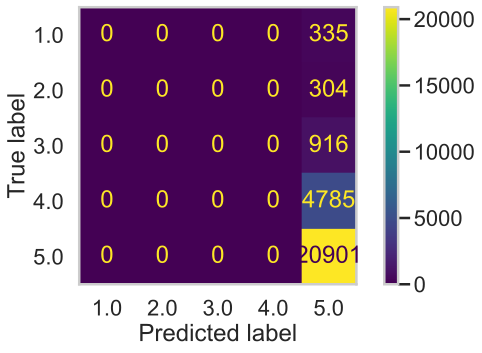

In [41]:
ConfusionMatrixDisplay.from_estimator(pl_base, X_val, y_val)
plt.grid(False)

In [42]:
base_df['rating'].value_counts() / base_df.shape[0]

5.0    0.77
4.0    0.18
3.0    0.03
1.0    0.01
2.0    0.01
Name: rating, dtype: float64

Turns out the original dataset is highly **imbalanced**, making the model always predicting a `rating` of 5 not missing many of the other details. This also means that as long as the model is always predicting the `rating` of 5, it will get an accuracy of 77% because 77% of the `rating` is 5 -> **accuracy doesn't entell everything!**. Thus, we need a better model than this that can capture some what more feature information, more engineering is needed!

Real world data is messy and no one would tell you whether the previous analysis is correct! This is why this is hard and why this is recurrent!

# Final Model: Homogenous Ensemble Learning
*"A good model is the combination of **model section** + **feature engineering** + **hyperparameter tuning**"*

Now with the previous baseline model's problem in mind, let's make some actual useful feature engineering, mainly we will be utilizing these features:

The previous features are carried over to this model, which includes:
1. binarized `n_step` with threshold 25, this is a result from eda
2. binarized `n_ingredients` with threshold 20, this is a result from eda
3. normalized `minutes` with respects to binarized `n_steps`
4. normalized `minutes` with respects to binarized `n_ingredients`
5. simple counts of `tags` column, showing how many tags are in each `tag` column

In addition, awe also added afew more features to capture the relationship we saw from EDA, whcih includes:
1. Some numerical columns of `sugar`,`sodium`,`calories`,`total_fat` that have being standerlized using `RobustScaler`
2. Two `TF-IDF` that have been `one hot encoded`:
    - In particular, the naive approach is to use the highest TF-IDF for each of the words are extracted for each of the sentence using `argmax`, representing the most important words in a sentence (we are using `argmax` here is for considering the complexity of this model, later implementations can utilzie more words that have high TF-IDF)
    - We then construct a pool of highest TF-IDF words in the **low** `rating` dataset, which was originally defined as `rating` lower than or equal to 3 and it is stored as a boolean indicator in the `is_low` column.
    - Finally, we want to see whether or not the current sentence's highest TF-IDF word is in such pool of words
    - We perform such operations with both the `name` column and also the `description` column
    - **Remark**: this feature improved the final model by roughly 10% accuracy, this is the `detect_key_low(df)` function
        - We ahve also tried to trade off some complexity with better accuracy by using the count of the 5 top TF-IDF words in each row (just this function runs for about 3m)
        - However, the performance didn't perform as well as `argmax`, whihch may be due to extra noise added (48% accuracy with 5 words and 50% accuracy with one word)
3. The `recipe_dtae` column have also being taken out with only the year of the recipe and then `one hot encoded` as well.
4. At last, we also used the `tag` column of each of the sentence to perform `one hot encoding`
    - We first performed `one hot encoding` to transform each tag to a numerical boolean representation. However, this makes the feature space to reahc to about 500 features, which adds too much **sparsity** to the feature space and may introduces **noises**
    - Thus we `filtered` out all the **irrelevant** or **low counted** tags (<1000 counts) and reduces teh feature spac  to only adding 80 more features
    - At last, we conducted `pca` to reduce the adding feature space to just abou 10 features and this value seems to work well with the data set experimentally.
    - The `tag_ohe_pca(df)` function takes care of this step
5. Analyzing whether the `review` columns contain certain sentiment words in it, evaluated by the `is_sentiment(df)` function
6. We have taken out irrelevant features such as the `naive_bayes` encoder taht we have implemented

In [43]:
def tag_counts(df):
    '''number of tags counted'''
    return pd.DataFrame(df['tags'].apply(lambda x: len(x)).rename('counts'))

def detect_key_low(df):
    '''transforming description's tfidf to actual most important word in a description
    then compare if it is in the low rated set'''

    def key_largest(row):
        return row.index[row.argmax()] #[row.argsort()][-5:]

    def make_tfidf(series):
        lst = series.explode().astype(str).values # this may be slow
        count = TfidfVectorizer()
        count.fit(lst)
        return pd.DataFrame(count.transform(lst).toarray(), columns=count.get_feature_names_out())
    
    tfidf_low = make_tfidf(df[df['is_low']==True][df.columns[1]])
    tfidf_base = make_tfidf(df[df.columns[1]])

    keyword_all = tfidf_base.apply(key_largest, axis=1) #argmax a bit faster
    keyword_low = tfidf_low.apply(key_largest, axis=1)
    pool_low = keyword_low.unique() #.explode().unique()

    in_low = keyword_all.apply(lambda x: x in pool_low)
    #.apply(lambda x: sum([word in pool_low for word in x]))

    return pd.DataFrame(in_low)

def tag_ohe_pca(df):
    '''OHE all the tag result after it have being pca dimension reduced to 50'''
    # getting all the unique one quick
    set = [j for i in df['tags'].tolist() for j in i]
    # explode in a time complexity efficient way
    count = CountVectorizer()
    count.fit(set).transform(set)

    my_dict = np.array(list(count.vocabulary_.keys()))

    def helper_function(list,dict):
        return np.array([i in list for i in dict])
    
    a = df["tags"].apply(lambda x:helper_function(x, my_dict))
    
    # change array of array into 2D array
    df_pca = pd.DataFrame(data = np.stack(a.to_numpy()),columns=my_dict)

    flipped = df_pca.T
    filter_df = flipped[flipped.sum(axis=1)>1000].T # keep only useful tags

    # conduct PCA to reduce to just 50 dimensions
    pca = PCA(n_components=10)
    reduced = pca.fit_transform(filter_df)

    return reduced

def is_sentiment(df):
    '''For detecting sentiment words in the review column'''

    word_list = ['awful', 'fav', 'well',
             'yet', 'fantastic',
             'pretty good','dislike','hate', 'bad', 
             'delicious', 'wonderful',
             'great', 'but', 'good', 'next', 
             'excellent', 'nice', 'bland', 'maybe', 
             'loved', 'sorry', 'think', 'however', 'would', 
             'perfect', 'very', 'keeper', 'liked', 'made']
    
    out = df['review'].apply(lambda x: word in x for word in word_list)

    return pd.DataFrame(out.astype(int))

## Final Model's Pipeline

Since this is a **multi-class classifictaion** problem and the data is also highly **imbalanced**, we are also adding a **dummy** classifier that classifies uniformally at random to bench mark our modle's performances. Of course, we will also use different evaluation metrics later to demonstarte the model's performances as well, the dummy classfier is just an "easy to view" example.

In [44]:
# dummy classfier with uniformally selections
dummy_clf = DummyClassifier(strategy="uniform")
dummy = dummy_clf.fit(X_train, y_train)

For the pipeline, we are still doing an **Homogenous Ensemble Learning** with decision tree as it have being shown to perform the best experimentally (we have tried hetergenous ensemble learning using voting/stacking with models such as SVM and logistic regression, but none of the perform as well as the simple random forest).

We balanced the dataset by using automatic balaning argumnet `"balanced"`, we have also tried to use self customized dictionaries for assigning weights, However, this wouldn't be generalizable to unseen data as the distribution of data changes. The `sk_learn` packages does automatic weight assigning by the following formula:

$n_samples / (n_classes * np.bincount(y))$

This model pipeline takes about 50 seconds to fit

In [45]:
norm_relative = Pipeline([
    ('bi_nsteps',Binarizer(threshold=25)),
    ('norm_minutes_binary_nsteps', FunctionTransformer(lambda x: StdScalerByGroup().fit(x).transform(x))),
])

key_ohe = Pipeline([
    ('tfidf',FunctionTransformer(detect_key_low)),
    ('key_ohe', OneHotEncoder(drop='first'))
])

date_ohe = Pipeline([
    ('date_get', FunctionTransformer(lambda x: pd.DataFrame(x['recipe_date'].dt.year))),
    ('date_ohe', OneHotEncoder())
])

preproc_rf = ColumnTransformer(
    transformers=[
        ('tfidf_key_ohe_description', key_ohe, ['is_low','description']),
        ('tfidf_key_ohe_name', key_ohe, ['is_low','name']),
        ('bi_nsteps', Binarizer(threshold=25),['n_steps']),
        ('bi_ningredients', Binarizer(threshold=20),['n_ingredients']),
        ('norm_minutes_binary_nsteps',norm_relative,['n_steps','minutes']),
        ('norm_minutes_binary_ningredients',norm_relative,['n_ingredients','minutes']),
        ('tag_counts',FunctionTransformer(tag_counts),['tags']), # good for predict 5
        ('robust_nutrition',RobustScaler(),['sugar','sodium','calories','total_fat']),
        ('date_ohe', date_ohe,['recipe_date']), # can't be too sparse, 10 max
        ('tag_pca',FunctionTransformer(tag_ohe_pca),['tags']),
        ('is_sentiment',FunctionTransformer(is_sentiment),['review'])
    ],
    remainder='drop'
)

class_weight= 'balanced' # balanced weighting automatically calculates th  best weighting!

pl_rf = Pipeline([
    ('preprocessor', preproc_rf),
    ('rfc', RandomForestClassifier(max_depth=18,
                                   n_estimators=130,
                                   criterion='entropy',
                                   min_samples_split=2,
                                   class_weight=class_weight
                                   ))
])

pl_rf.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('tfidf_key_ohe_description',
                                                  Pipeline(steps=[('tfidf',
                                                                   FunctionTransformer(func=<function detect_key_low at 0x16853d670>)),
                                                                  ('key_ohe',
                                                                   OneHotEncoder(drop='first'))]),
                                                  ['is_low', 'description']),
                                                 ('tfidf_key_ohe_name',
                                                  Pipeline(steps=[('tfidf',
                                                                   FunctionTransformer(func=<function detect_key_low at 0x...
                                                                   FunctionTransformer(func=<function <lambda> at 0x1689ca940>)),
                 

## Hyperparameter Tunning
We have performed `GridSearchCV` for the best parameters for the Random Forest Classifier. However, for the complexity of running this notebook, we only tuned the model once and then turned this cell off. We are tuning for `max_depth`, `n_estimator`, and `criterion`.

In [46]:
# %time
# hyperparameters = {
# 'rfc__max_depth': np.arange(2, 20, 2),
# 'rfc__n_estimators': np.arange(100, 150, 10),
# }

# grids = GridSearchCV(pl_rf,
#                      n_jobs=-1,
#                      param_grid=hyperparameters,
#                      return_train_score=False,
#                      cv=5
#                      )

# grids = RandomizedSearchCV(pl_rf,
#                            param_distributions=hyperparameters,
#                            n_jobs=-1,
#                            return_train_score=False,
#                            cv=5
#                            )

# grids.fit(X_train, y_train)
# grids.fit(X_train, y_train)
# grids.best_params_

Hyperparameter tuning is relatively simpler comparing to the transformation section. We performed **grid search** hyperparameter tuning with the K-fold of 5 and then found the best `max_depth` for this random forest classifier to be 18, the `num_estimators` to be 130, and the `criterion` to be entropy. This seems to be quite a good parameter as it performs quite well in practice, not **over fitiing** nor **under fitting**.

## Model Evaluation
We will be conducting some simple evaluation with the model in this section with confusion matrix just to see the basic performance of the model. A more detaile  performance evaluation would be conducted in the **Test Data Evaluation** section.

To really understand what we are evaluating, we need to first understand what metrics matters to us:
- **Precision for 5**: Out of all 5 we predicted, how many are actually 5 
- **Recall for 5**: Out of all actual 5, how many did we get right

We care about getting a correct rating for reconmandation, we care about finding **Recall** but still considering precision, accuracy, F1 scores

### Feature Importantness Analysis

We have 60 features in our model with feature 0 and feature 1 having the most effect! these are the 2 argmax `TF-IDF` encoder that we have implemented, this is consistent with ou previous **permutation testing** that shows the `TF-IDF` distribution for `high_rated` and `low_rated` recipes are different distributions.

Other than that, the second highest feature importantness is teh forth feature to the 11th feature and 22th feature to 31th feature. These correspond to the `tag_pca` column!

In [47]:
# for evaluating
def metrics_all(model, X, y):
    return pd.DataFrame(precision_recall_fscore_support(model.predict(X), y),
             index=['precision','recall','f1_score','count'],
             columns=[1,2,3,4,5]).T

Confusion matrix for random forest classifier

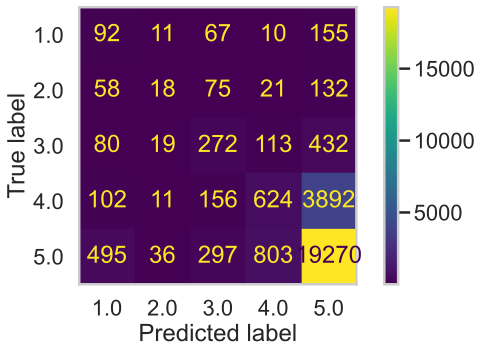

In [48]:
ConfusionMatrixDisplay.from_estimator(pl_rf, X_val, y_val)
plt.grid(False)

Confusion matrix for dummy classifier

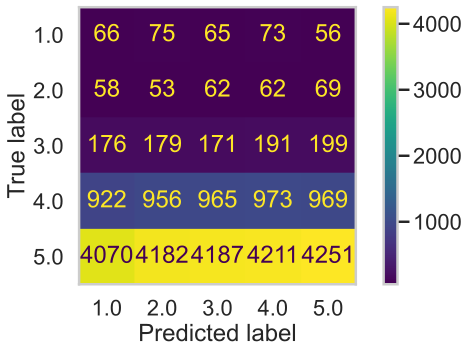

In [49]:
ConfusionMatrixDisplay.from_estimator(dummy, X_val, y_val)
plt.grid(False)

Accuracy for random forest classifier

In [50]:
pl_rf.score(X_val, y_val)

0.7443192246980654

Accuracy for dummy classifier

In [51]:
dummy.score(X_val, y_val)

0.20153445174553064

Full metrics for random forest classfier

In [52]:
metrics_all(pl_rf, X_val, y_val)

,precision,recall,f1_score,count
1,0.27,0.11,0.15,829.0
2,0.06,0.19,0.09,98.0
3,0.29,0.31,0.30,855.0
4,0.13,0.39,0.20,1578.0
5,0.92,0.81,0.86,23881.0


Full metrics for dummy classifier

In [53]:
metrics_all(dummy, X_val, y_val)

,precision,recall,f1_score,count
1,0.19,0.01,0.02,5559.0
2,0.20,0.01,0.02,5342.0
3,0.19,0.03,0.05,5399.0
4,0.19,0.17,0.18,5444.0
5,0.20,0.76,0.32,5497.0


## Testing for Evaluation
Recall that when we evaluate a model, we need to look at multiple metrics to really understand how our model is performing. From the baseline model, we know that **accuracy can really lie!** We can borrow a image from [here](https://towardsdatascience.com/comprehensive-guide-to-multiclass-classification-with-sklearn-127cc500f362) to demonstrate what we are evaluating really quickly

<center><img src="imgs/evaluation.png" width=110%></center>

Let's look at the confusion matrix again first, but this time in a percentage form.

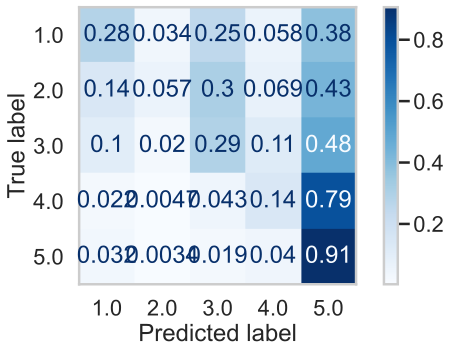

In [54]:
ConfusionMatrixDisplay.from_estimator(pl_rf, X_test, y_test, cmap=plt.cm.Blues, normalize='true')
plt.grid(False)

In [55]:
pl_rf.score(X_test, y_test)

0.7339280306158972

In [56]:
metrics_all(pl_rf, X_test, y_test)

,precision,recall,f1_score,count
1,0.28,0.10,0.14,1334.0
2,0.05,0.11,0.07,186.0
3,0.28,0.25,0.26,1396.0
4,0.14,0.41,0.21,2220.0
5,0.91,0.81,0.85,31185.0


Let's formalize the test result by using the `classification_report` function from `sk_learn`
- The bottom of the table shows 2 different aspects of the prediction evaluation,
    1. one is `macro_avg` or the simple average for each of teh column of evaluation metrics
    2. one is `weighted_avg`, which re-evaluate the accuracy of our modle based on the data distribution of the data set, whcih provide a better representation of the model's performance given imbalanced data like this one.

In [57]:
print(classification_report(y_test, pl_rf.predict(X_test)))

              precision    recall  f1-score   support

         1.0       0.09      0.29      0.14       447
         2.0       0.12      0.06      0.08       405
         3.0       0.25      0.28      0.26      1222
         4.0       0.40      0.14      0.21      6380
         5.0       0.81      0.91      0.85     27867

    accuracy                           0.73     36321
   macro avg       0.33      0.33      0.31     36321
weighted avg       0.70      0.73      0.70     36321



After the `weighted_avg` evaluation, it looks like our model achieves a pretty good performance, 3 of them (precision, recall, and f1 score) all being **70%**! This is quite good considering we are doing a multi class classification, for comparison, we can intoduce the uniformaly dummy clasfier to make a baseline comparison.

In [58]:
print(classification_report(y_test, dummy.predict(X_test)))

              precision    recall  f1-score   support

         1.0       0.01      0.21      0.02       447
         2.0       0.01      0.20      0.02       405
         3.0       0.03      0.21      0.06      1222
         4.0       0.18      0.20      0.19      6380
         5.0       0.77      0.20      0.31     27867

    accuracy                           0.20     36321
   macro avg       0.20      0.20      0.12     36321
weighted avg       0.62      0.20      0.28     36321



Clearly, there is a difference in the recall and f1 score. There isn't that big of a differences in precision for the weighted avg because the number of 5 rating are plenty in the data set (77%), causing the precision for 5 to reach 77% directly.

Comparing with the baseline model on testing data set:

In [59]:
print(classification_report(y_test, pl_base.predict(X_test)))

              precision    recall  f1-score   support

         1.0       0.00      0.00      0.00       447
         2.0       0.00      0.00      0.00       405
         3.0       0.00      0.00      0.00      1222
         4.0       0.00      0.00      0.00      6380
         5.0       0.77      1.00      0.87     27867

    accuracy                           0.77     36321
   macro avg       0.15      0.20      0.17     36321
weighted avg       0.59      0.77      0.67     36321



/Users/kevinb/miniforge3/envs/dsc80/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/kevinb/miniforge3/envs/dsc80/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/kevinb/miniforge3/envs/dsc80/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Our final model is a lot better! As it can be seen from the table above, the baseline model is just predicting the `rating` of 5 and neglecting all other ratings, making them having a recall and precision all equals to zero. Though the final weighted data seems to be okay, the baseline model is not a really good classifier.

Next, we want to also look at the `ROC_AUC` score or **area under the receiver operating characteristic curve**. Again, like many metrics, they are originally designed for binary classfications, but we can also apply to multi-class classfications by doing `ovr` strategy (estimating by making grouped for comparison).

In [60]:
y_pred_probs = pl_rf.predict_proba(X_test)

roc_auc_score(
    y_test, y_pred_probs, multi_class="ovr", average="weighted"
  )

0.7023426922363997

This is pretty good! from [here](https://en.wikipedia.org/wiki/Receiver_operating_characteristic) we can show the curve of ROC for different performance of an classfier. Our model's performance shows that about about 70% of teh area are covered, signifying that our model performs quite well!
<center><img src="imgs/roc.png" width=35%></center>

We have also drawn a ROC curve ourselves, this is a weighted ROC graph already as multiclass classification results can not directly be plotted on a 2D ROC graph, the calculation is conducted using the equations from `sk_learn`'s metrics repository.

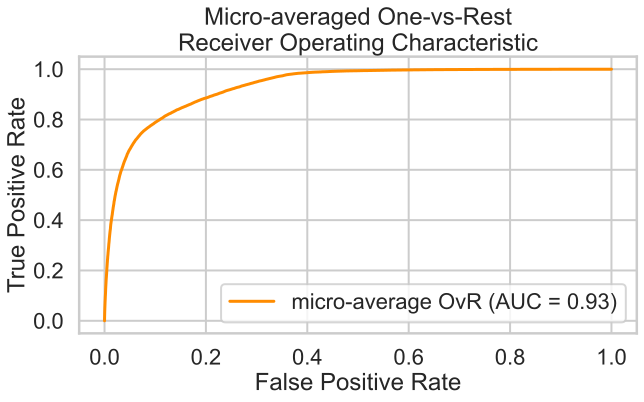

In [61]:
label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

display = RocCurveDisplay.from_predictions(
    y_onehot_test.ravel(),
    y_pred_probs.ravel(),
    name="micro-average OvR",
    color="darkorange"
    )

display_set_axes = display.ax_.set(
    xlabel="False Positive Rate",
    ylabel="True Positive Rate",
    title="Micro-averaged One-vs-Rest\nReceiver Operating Characteristic"
    )

# Fairness Analysis
We want to evaluate whether the model is fair for treating all populations. In particular, we want to check in the scope of looking at the predictions for the `vegan` group and the `vegetarian` group. Let's first check how many of them are in the data set.

In [62]:
X_test['tags'].apply(lambda x: 'vegetarian' in x).sum()

5387

In [63]:
X_test['tags'].apply(lambda x: 'vegan' in x).sum()

1356

In [64]:
out = X_test.assign(prediction = pl_rf.predict(X_test))

In [65]:
is_in_tag = out['tags'].apply(lambda x: ('vegetarian' in x)|('vegan' in x))
out = out.assign(is_in = is_in_tag)

Let's check the grouped by mean first

In [66]:
out.groupby('is_in')['prediction'].mean()

is_in
False    4.69
True     4.75
Name: prediction, dtype: float64

### Difference Significant?

We run a **permutation test** to see if the difference in accuracy is significant.
- **Null Hypothesis**: The classifier's accuracy is the same for both `vegan` + `vegetarian` tags and non `vegan` + `vegetarian` tags, and any differences are due to chance.
- **Alternative Hypothesis**: The classifier's accuracy is higher for non `vegan` + `vegetarian` tags.
- **Quantitative Attribute**: Accuracy
- **Test Statistic**: Difference in accuracy (is_in minus not_in).
- **Testing Significance Level**: p=0.05

In [67]:
compute_accuracy = lambda x: metrics.accuracy_score(x['is_in'], x['prediction'])
obs = out.groupby('is_in').apply(compute_accuracy).diff().iloc[-1]

diff_in_acc = []
for _ in range(1000):
    s = (
        out[['is_in', 'prediction']]
        .assign(shuffle=np.random.permutation(out['is_in']))
        .groupby('shuffle')
        .apply(compute_accuracy)
        .diff()
        .iloc[-1]
    ) 
    diff_in_acc.append(s)

cutoff = np.quantile(null, 0.95)

fig = pd.Series(diff_in_acc).plot(kind='hist', histnorm='probability',
                            title='Difference in Accuracy (Is_in - Not_in)')
fig.add_vline(x=obs, line_color='red', line_width=1, opacity=1)
fig.add_vline(x=cutoff, line_color='blue', line_width=1, opacity=1)
fig.add_annotation(text=f'<span style="color:red">Observed Difference in Means = {round(obs, 2)}</span>',
                    x=obs, showarrow=False, y=0.06)
fig.add_annotation(text=f'<span style="color:blue">Signicicant Level = {round(cutoff, 2)}</span>',
                    x=cutoff, showarrow=False, y=0.10)
fig.show()

In [68]:
(obs <= diff_in_acc).mean()

0.0

The result is **significant**, we reject the null hypothesis!